[Click here to download datasets used in this notebook](https://drive.google.com/drive/folders/1DOf6Mqx33DJCnCJa3A9AFHO0nG76cMrN)

#### 1. How to read data from SQLite DataBase

In [66]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [67]:
import sqlite3

In [68]:
conn = sqlite3.connect("database.sqlite")

In [69]:
# use anaconda command prompt for getting table names

In [70]:
df = pd.read_sql("SELECT * FROM REVIEWS", conn)

In [71]:
df.shape

(568454, 10)

In [72]:
df

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...
...,...,...,...,...,...,...,...,...,...,...
568449,568450,B001EO7N10,A28KG5XORO54AY,Lettie D. Carter,0,0,5,1299628800,Will not do without,Great for sesame chicken..this is a good if no...
568450,568451,B003S1WTCU,A3I8AFVPEE8KI5,R. Sawyer,0,0,2,1331251200,disappointed,I'm disappointed with the flavor. The chocolat...
568451,568452,B004I613EE,A121AA1GQV751Z,"pksd ""pk_007""",2,2,5,1329782400,Perfect for our maltipoo,"These stars are small, so you can give 10-15 o..."
568452,568453,B004I613EE,A3IBEVCTXKNOH,"Kathy A. Welch ""katwel""",1,1,5,1331596800,Favorite Training and reward treat,These are the BEST treats for training and rew...


In [73]:
df.isna().sum()

Id                        0
ProductId                 0
UserId                    0
ProfileName               0
HelpfulnessNumerator      0
HelpfulnessDenominator    0
Score                     0
Time                      0
Summary                   0
Text                      0
dtype: int64

In [74]:
df.duplicated().sum()

0

In [75]:
df.dtypes

Id                         int64
ProductId                 object
UserId                    object
ProfileName               object
HelpfulnessNumerator       int64
HelpfulnessDenominator     int64
Score                      int64
Time                       int64
Summary                   object
Text                      object
dtype: object

#### 2. Data Preparation 

In [76]:
df.sample(3)

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
365145,365146,B001M074LA,A2SMASZZGNYIAP,shmoo1412,0,0,3,1349395200,Can't wait till I can get the Senseo products,I have been buying these since there has been ...
185549,185550,B004WZ4EIS,AKJ6ULSBWUWGJ,"Bridget ""tasson""",0,0,5,1346889600,What SeaSnax Roasted Olive Seaweed?????,Guilty confession: it disappears so fast you c...
34095,34096,B004N8LMFM,A3M9ZZBFO631MM,Boo4Bugs,4,4,5,1321315200,Great For Sushi Lovers!,I bought this for my daughter and she loved it...


In [77]:
(df["HelpfulnessNumerator"] <= df["HelpfulnessDenominator"]).sum()

568452

In [78]:
len(df)

568454

In [79]:
df_valid = df[ df["HelpfulnessNumerator"] <= df["HelpfulnessDenominator"] ]

In [80]:
df_valid.shape

(568452, 10)

In [81]:
df[ ~ (df["HelpfulnessNumerator"] <= df["HelpfulnessDenominator"]) ] #invalid rows

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
44736,44737,B001EQ55RW,A2V0I904FH7ABY,Ram,3,2,4,1212883200,Pure cocoa taste with crunchy almonds inside,It was almost a 'love at first bite' - the per...
64421,64422,B000MIDROQ,A161DK06JJMCYF,"J. E. Stephens ""Jeanne""",3,1,5,1224892800,Bought This for My Son at College,My son loves spaghetti so I didn't hesitate or...


In [82]:
# no user can write same review at same time

In [83]:
df_valid.duplicated(subset=["UserId", "ProfileName", "Time", "Text"]).sum()

174521

In [84]:
df_valid[df_valid.duplicated(subset=["UserId", "ProfileName", "Time", "Text"])]  #duplicate rows

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
29,30,B0001PB9FY,A3HDKO7OW0QNK4,Canadian Fan,1,1,5,1107820800,The Best Hot Sauce in the World,I don't know if it's the cactus or the tequila...
574,575,B000G6RYNE,A3PJZ8TU8FDQ1K,Jared Castle,2,2,5,1231718400,"One bite and you'll become a ""chippoisseur""","I'm addicted to salty and tangy flavors, so wh..."
1973,1974,B0017165OG,A2EPNS38TTLZYN,tedebear,0,0,3,1312675200,Pok Chops,The pork chops from Omaha Steaks were very tas...
2309,2310,B0001VWE0M,AQM74O8Z4FMS0,Sunshine,0,0,2,1127606400,Below standard,Too much of the white pith on this orange peel...
2323,2324,B0001VWE0C,AQM74O8Z4FMS0,Sunshine,0,0,2,1127606400,Below standard,Too much of the white pith on this orange peel...
...,...,...,...,...,...,...,...,...,...,...
568409,568410,B0018CLWM4,A2PE0AGWV6OPL7,Dark Water Mermaid,3,3,5,1309651200,Quality & affordable food,I was very pleased with the ingredient quality...
568410,568411,B0018CLWM4,A88HLWDCU57WG,R28,2,2,5,1332979200,litter box,My main reason for the five star review has to...
568411,568412,B0018CLWM4,AUX1HSY8FX55S,DAW,1,1,5,1319500800,Happy Camper,I bought this to try on two registered Maine C...
568412,568413,B0018CLWM4,AVZ2OZ479Q9E8,Ai Ling Chow,0,0,5,1336435200,Two Siberians like it!,When we brought home two 3-month-old purebred ...


In [85]:
data = df_valid.drop_duplicates(subset=["UserId", "ProfileName", "Time", "Text"]).copy()

[Explanation Video for copywarning in pandas](https://www.youtube.com/watch?v=4R4WsDJ-KVc&ab_channel=DataSchool)

In [86]:
data.dtypes

Id                         int64
ProductId                 object
UserId                    object
ProfileName               object
HelpfulnessNumerator       int64
HelpfulnessDenominator     int64
Score                      int64
Time                       int64
Summary                   object
Text                      object
dtype: object

In [87]:
data.Time

0         1303862400
1         1346976000
2         1219017600
3         1307923200
4         1350777600
             ...    
568449    1299628800
568450    1331251200
568451    1329782400
568452    1331596800
568453    1338422400
Name: Time, Length: 393931, dtype: int64

In [88]:
data['Time'] = pd.to_datetime(data.Time, unit='s') #default value of unit is 'ns'(nano-seconds) refer docs

#### 3. Analyse to what User Amazon can recommend more products

In [89]:
data.sample(2)

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
544227,544228,B002YR7B7C,APO4VJLLXAW71,"Hannah ""Aunty Nanny""",4,5,5,2010-09-10,Best gf all-purpose blend,"My sister and I are gluten-free, and we both d..."
353752,353753,B005A1LINC,A2ZGXQ566SR4FM,Patrizia,0,0,5,2012-04-15,Love this and wasn't sure I would!,I loved the taste of this and I am not a drink...


In [90]:
data.nunique()

Id                        393931
ProductId                  67624
UserId                    256059
ProfileName               218418
HelpfulnessNumerator         230
HelpfulnessDenominator       233
Score                          5
Time                        3168
Summary                   294827
Text                      393577
dtype: int64

In [91]:
len(data)

393931

In [92]:
grouped = data.groupby("UserId").agg({'Summary':'count',
                            'Text':'count',
                            'Score':'mean',
                            'ProductId': 'count'})

grouped.columns= ["Number_of_summaries", "num_text", "Avg_score", "Number_of_products_purchased"]

<Axes: xlabel='UserId'>

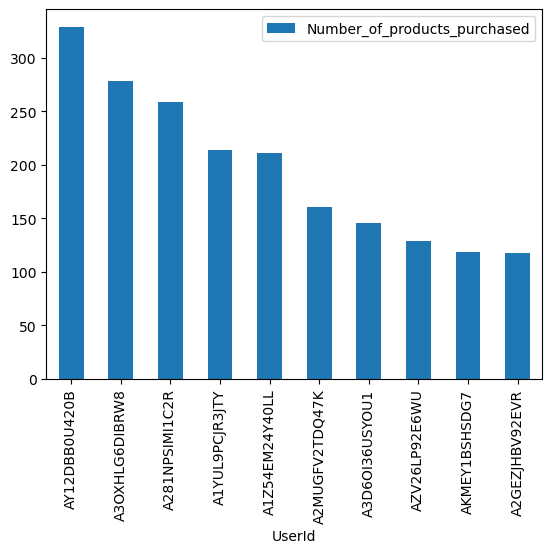

In [93]:
grouped.sort_values(by="Number_of_products_purchased", ascending=False)[:10].plot(y="Number_of_products_purchased",kind="bar")

#### 4. Analysing which product has good number of Reviews

In [94]:
data.nunique()

Id                        393931
ProductId                  67624
UserId                    256059
ProfileName               218418
HelpfulnessNumerator         230
HelpfulnessDenominator       233
Score                          5
Time                        3168
Summary                   294827
Text                      393577
dtype: int64

In [95]:
prod_count = data["ProductId"].value_counts().to_frame()

In [96]:
prod_count[ prod_count["count"]>500]

,count
ProductId,
B007JFMH8M,912
B002QWP89S,630
B003B3OOPA,622
B001EO5Q64,566
B0013NUGDE,558
B000KV61FC,556
B000UBD88A,542
B000NMJWZO,542
B005K4Q37A,541


In [97]:
freq_prod_ids = list( prod_count[ prod_count["count"]>500].index )
freq_prod_ids

['B007JFMH8M',
 'B002QWP89S',
 'B003B3OOPA',
 'B001EO5Q64',
 'B0013NUGDE',
 'B000KV61FC',
 'B000UBD88A',
 'B000NMJWZO',
 'B005K4Q37A',
 'B0090X8IPM',
 'B005ZBZLT4']

In [98]:
freq_prod_data = data[ data["ProductId"].isin(freq_prod_ids) ]
freq_prod_data

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
20982,20983,B002QWP89S,A21U4DR8M6I9QN,"K. M Merrill ""justine""",1,1,5,2011-10-18,addictive! but works for night coughing in dogs,my 12 year old sheltie has chronic brochotitis...
20983,20984,B002QWP89S,A17TDUBB4Z1PEC,jaded_green,1,1,5,2011-10-14,genuine Greenies best price,"These are genuine Greenies product, not a knoc..."
20984,20985,B002QWP89S,ABQH3WAWMSMBH,tenisbrat87,1,1,5,2011-09-28,Perfect for our little doggies,"Our dogs love Greenies, but of course, which d..."
20985,20986,B002QWP89S,AVTY5M74VA1BJ,tarotqueen,1,1,5,2011-09-24,dogs love greenies,"What can I say, dogs love greenies. They begg ..."
20986,20987,B002QWP89S,A13TNN54ZEAUB1,dcz2221,1,1,5,2011-09-23,Greenies review,This review is for a box of Greenies Lite for ...
...,...,...,...,...,...,...,...,...,...,...
563878,563879,B007JFMH8M,A366PSH7KFLRPB,TheRosySnail,0,0,5,2012-07-29,Yummy!,I loved these cookies and so did my kids. You ...
563879,563880,B007JFMH8M,A2KV6EYQPKJRR5,Kelley,0,0,5,2012-07-28,Quaker Soft Baked Cookies,This is a great tasting cookie. It is very sof...
563880,563881,B007JFMH8M,A3O7REI0OSV89M,Esme,0,0,4,2012-07-28,Delicious!,These are great for a quick snack! They are sa...
563881,563882,B007JFMH8M,A9JS5GQQ6GIQT,Syne,0,0,5,2012-07-28,yummy,I love the Quaker soft baked cookies. The rea...


<Axes: xlabel='count', ylabel='ProductId'>

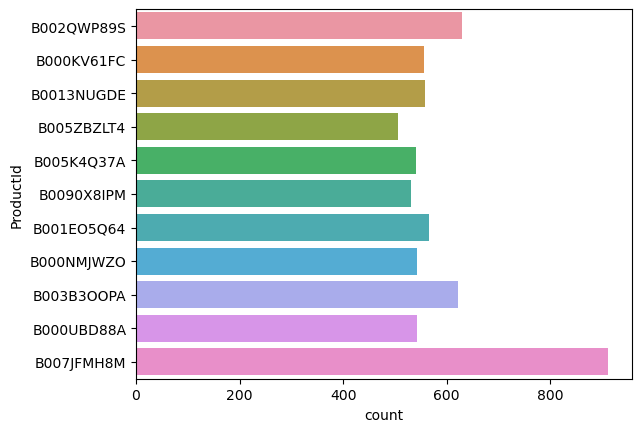

In [99]:
sns.countplot(data=freq_prod_data, y="ProductId")

<Axes: xlabel='count', ylabel='ProductId'>

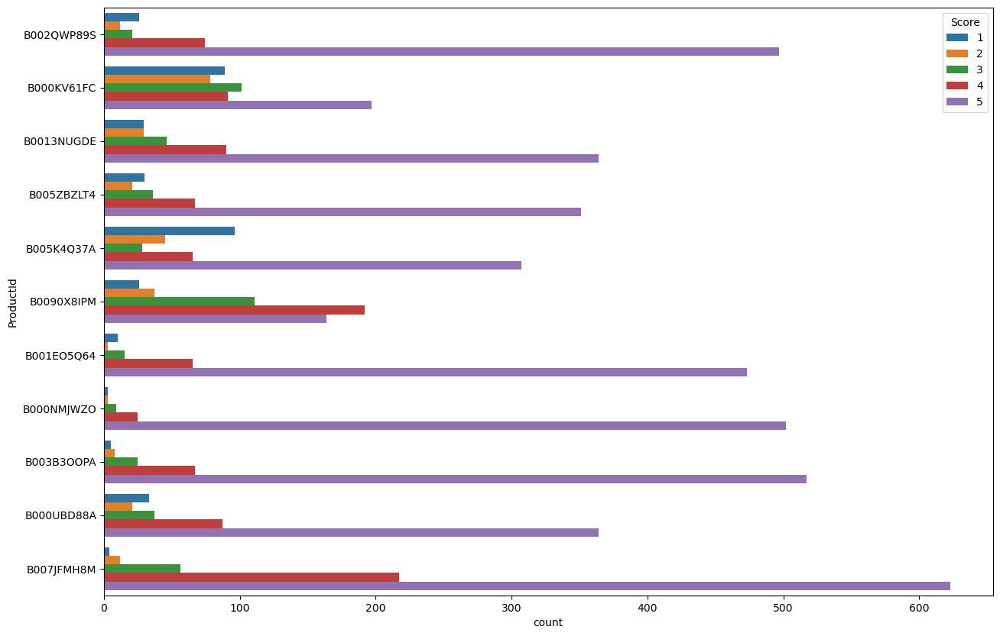

In [100]:
plt.figure(figsize=(15,10))
sns.countplot(data=freq_prod_data, y="ProductId", hue="Score")

#### 5. Is there any difference between behaviour of frequent viewers & not frequent viewers

frequent viewers --> User purchased more than 50 total products

not frequent viewers --> User purchased less than 50 total products

In [101]:
user_freq_df = data["UserId"].value_counts().to_frame()

In [102]:
freq_user_list = list(user_freq_df[ user_freq_df["count"]>=50].index)

In [103]:
data["viewer_type"] = data["UserId"].apply(lambda x : "Frequent" if x in freq_user_list else "Not Frequent")

In [104]:
data["viewer_type"].unique()

array(['Not Frequent', 'Frequent'], dtype=object)

In [105]:
freq_df = data[ data["viewer_type"] == "Frequent"]

In [106]:
non_freq_df = data[ data["viewer_type"] == "Not Frequent"]

In [107]:
freq_df["Score"].value_counts() / len(freq_df) *100

Score
5    61.461197
4    21.146120
3     9.674350
2     3.954324
1     3.764009
Name: count, dtype: float64

In [108]:
non_freq_df["Score"].value_counts() / len(non_freq_df) *100

Score
5    63.762085
4    14.069388
1     9.350462
3     7.504818
2     5.313247
Name: count, dtype: float64

<Axes: xlabel='Score'>

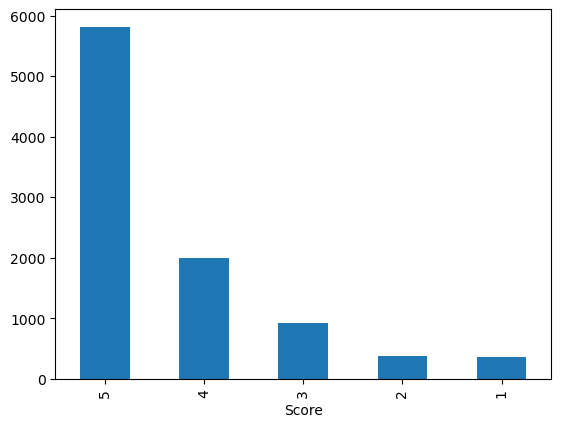

In [109]:
freq_df["Score"].value_counts().plot(kind="bar")

<Axes: xlabel='Score'>

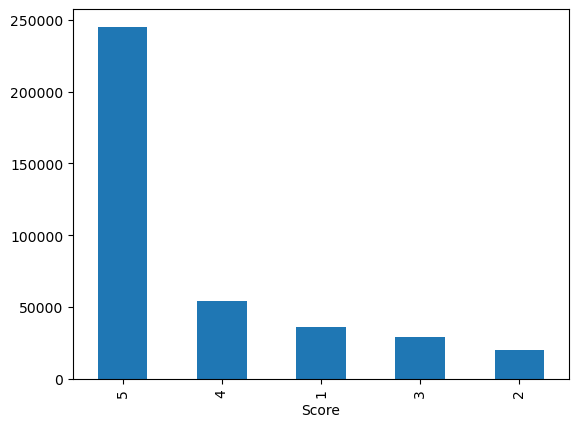

In [110]:
non_freq_df["Score"].value_counts().plot(kind="bar")

#### 6. Analysing your frequent Users are more verbose or not

Verbose --> someone who posts a lot

In [111]:
data['Text_length'] = data["Text"].apply(lambda x : len(x.split(" ")))

In [112]:
data

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,viewer_type,Text_length
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,2011-04-27,Good Quality Dog Food,I have bought several of the Vitality canned d...,Not Frequent,49
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,2012-09-07,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,Not Frequent,31
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,2008-08-18,"""Delight"" says it all",This is a confection that has been around a fe...,Not Frequent,99
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,2011-06-13,Cough Medicine,If you are looking for the secret ingredient i...,Not Frequent,43
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,2012-10-21,Great taffy,Great taffy at a great price. There was a wid...,Not Frequent,30
...,...,...,...,...,...,...,...,...,...,...,...,...
568449,568450,B001EO7N10,A28KG5XORO54AY,Lettie D. Carter,0,0,5,2011-03-09,Will not do without,Great for sesame chicken..this is a good if no...,Not Frequent,26
568450,568451,B003S1WTCU,A3I8AFVPEE8KI5,R. Sawyer,0,0,2,2012-03-09,disappointed,I'm disappointed with the flavor. The chocolat...,Not Frequent,46
568451,568452,B004I613EE,A121AA1GQV751Z,"pksd ""pk_007""",2,2,5,2012-02-21,Perfect for our maltipoo,"These stars are small, so you can give 10-15 o...",Not Frequent,71
568452,568453,B004I613EE,A3IBEVCTXKNOH,"Kathy A. Welch ""katwel""",1,1,5,2012-03-13,Favorite Training and reward treat,These are the BEST treats for training and rew...,Not Frequent,37


In [113]:
freq_data = data[ data["viewer_type"] == "Frequent"]

In [114]:
not_freq_data = data[ data["viewer_type"] == "Not Frequent"]

[(0.0, 700.0)]

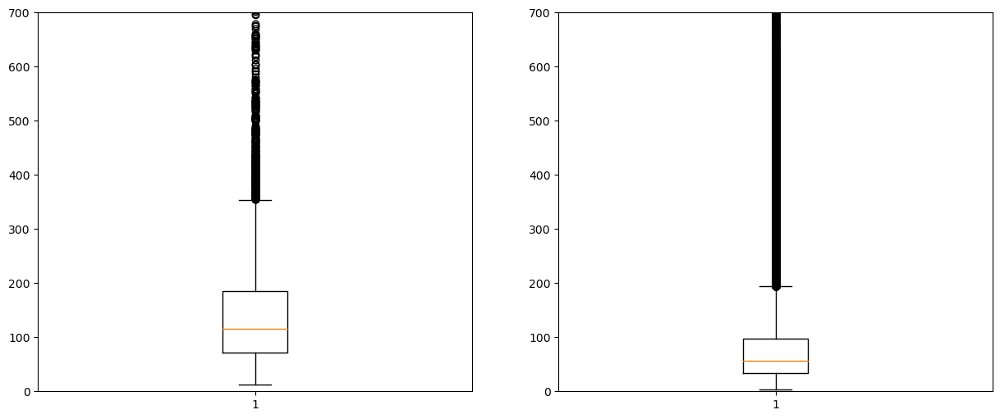

In [115]:
fig = plt.figure(figsize=(15,6))

ax1 = fig.add_subplot(121)
ax1.boxplot(freq_data["Text_length"])
ax1.set(ylim=[0,700])

ax2 = fig.add_subplot(122)
ax2.boxplot(not_freq_data["Text_length"])
ax2.set(ylim=[0,700])

In [116]:
#another way

In [117]:
import plotly.express as px

In [118]:
fig = px.box(x="viewer_type", data_frame=data, y="Text_length")
fig.update_yaxes(range=[0, 600])
fig.show()

#### 7. sentiment analysis

In [119]:
from textblob import TextBlob

In [120]:
data['Summary'][0]

'Good Quality Dog Food'

In [121]:
TextBlob('Good Quality Dog Food').sentiment.polarity

0.7

In [122]:
data.shape

(393931, 12)

In [123]:
%%time

data['polarity'] = data['Summary'].apply(lambda x : TextBlob(x).sentiment.polarity)

CPU times: total: 1min 7s
Wall time: 2min 43s


In [127]:
data_negative = data [ data["polarity"]<0 ].copy()

data_positive = data [ data["polarity"]>0 ].copy()

In [146]:
from collections import Counter

In [147]:
Counter(data_negative["Summary"]).most_common(10)

[('Disappointed', 426),
 ('Disappointing', 223),
 ('Not what I expected', 143),
 ('Awful', 120),
 ('disappointed', 120),
 ('Horrible', 111),
 ('Terrible', 107),
 ('Disgusting', 89),
 ('Not good', 78),
 ('Bland', 64)]

In [148]:
Counter(data_positive["Summary"]).most_common(10)

[('Delicious!', 1768),
 ('Delicious', 1682),
 ('Great product', 765),
 ('Excellent', 713),
 ('Love it!', 649),
 ('Great Product', 648),
 ('Great!', 529),
 ('Great', 506),
 ('Awesome', 396),
 ('Awesome!', 394)]